In [1]:
!nvidia-smi

Wed Jul 30 22:11:54 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   34C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

!cp /content/gdrive/MyDrive/myDataSet.zip /content

Mounted at /content/gdrive


In [3]:
!unzip -q /content/myDataSet.zip -d /content/custom_data

In [4]:
!wget -O /content/train_val_split.py https://raw.githubusercontent.com/EdjeElectronics/Train-and-Deploy-YOLO-Models/refs/heads/main/utils/train_val_split.py


!python train_val_split.py --datapath="/content/custom_data" --train_pct=0.9

--2025-07-30 22:12:56--  https://raw.githubusercontent.com/EdjeElectronics/Train-and-Deploy-YOLO-Models/refs/heads/main/utils/train_val_split.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.111.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3203 (3.1K) [text/plain]
Saving to: ‘/content/train_val_split.py’

/content/train_val_ 100%[===================>]   3.13K  --.-KB/s    in 0s      

2025-07-30 22:12:56 (33.7 MB/s) - ‘/content/train_val_split.py’ saved [3203/3203]

Created folder at /content/data/train/images.
Created folder at /content/data/train/labels.
Created folder at /content/data/validation/images.
Created folder at /content/data/validation/labels.
Number of image files: 226
Number of annotation files: 226
Images moving to train: 203
Images moving to validation: 23


In [5]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 26.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 95.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 93.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 59.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 107.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling

In [10]:
import os
import yaml

def create_data_yaml(path_to_classes_txt, path_to_data_yaml):

  if not os.path.exists(path_to_classes_txt):
    print(f'classes.txt file not found')
    return

  with open(path_to_classes_txt, 'r') as f:
    classes=[]
    for line in f.readlines():
      if len(line.strip()) == 0: continue
      classes.append(line.strip())
    num_classes = len(classes)


    data = {
        'path' : '/content/data',
        'train' : 'train/images',
        'val' : 'validation/images',
        'nc' : num_classes,
        'names' : classes
    }


    with open(path_to_data_yaml, 'w') as f:
      yaml.dump(data, f, sort_keys=False)
      print(f'created config file at {path_to_data_yaml}')

      return

path_to_classes_txt = '/content/custom_data/classes.txt'
path_to_data_yaml = '/content/data.yaml'
create_data_yaml(path_to_classes_txt, path_to_data_yaml)

print('/nFile contents:\n')
!cat /content/data.yaml

created config file at /content/data.yaml
/nFile contents:

path: /content/data
train: train/images
val: validation/images
nc: 9
names:
- book
- calculator
- flash memory
- highlighter
- marker
- pencil
- ruler
- sharpie
- tape


In [11]:
!yolo detect train data =/content/data.yaml model=yolo11n.pt epochs=40 imgsz=640

Ultralytics 8.3.170 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=40, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained=True, pr

In [13]:
!yolo detect predict model=runs/detect/train2/weights/best.pt source=data/validation/images save=True

Ultralytics 8.3.170 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,583,907 parameters, 0 gradients, 6.3 GFLOPs

image 1/23 /content/data/validation/images/082ae1b9__2dfbc31a-IMG_3976.jpg: 640x480 1 book, 50.2ms
image 2/23 /content/data/validation/images/13990d2c__93fd1c80-IMG_4043.jpg: 480x640 2 highlighters, 1 marker, 1 ruler, 2 sharpies, 44.8ms
image 3/23 /content/data/validation/images/14a5c016__d91d1d6d-IMG_4120.jpg: 640x480 1 marker, 9.8ms
image 4/23 /content/data/validation/images/1a0d8a65__ebe6baf0-IMG_3992.jpg: 480x640 1 book, 9.7ms
image 5/23 /content/data/validation/images/1d1e315c__4bde741d-IMG_4140.jpg: 640x480 1 marker, 1 sharpie, 9.4ms
image 6/23 /content/data/validation/images/23baa552__bfad185c-IMG_4102.jpg: 640x480 1 calculator, 9.1ms
image 7/23 /content/data/validation/images/31bc1c67__15f9de15-IMG_4004.jpg: 640x480 3 books, 1 flash memory, 1 highlighter, 1 marker, 1 ruler, 2 sharpies, 17.8ms
image 8/23 /content/d

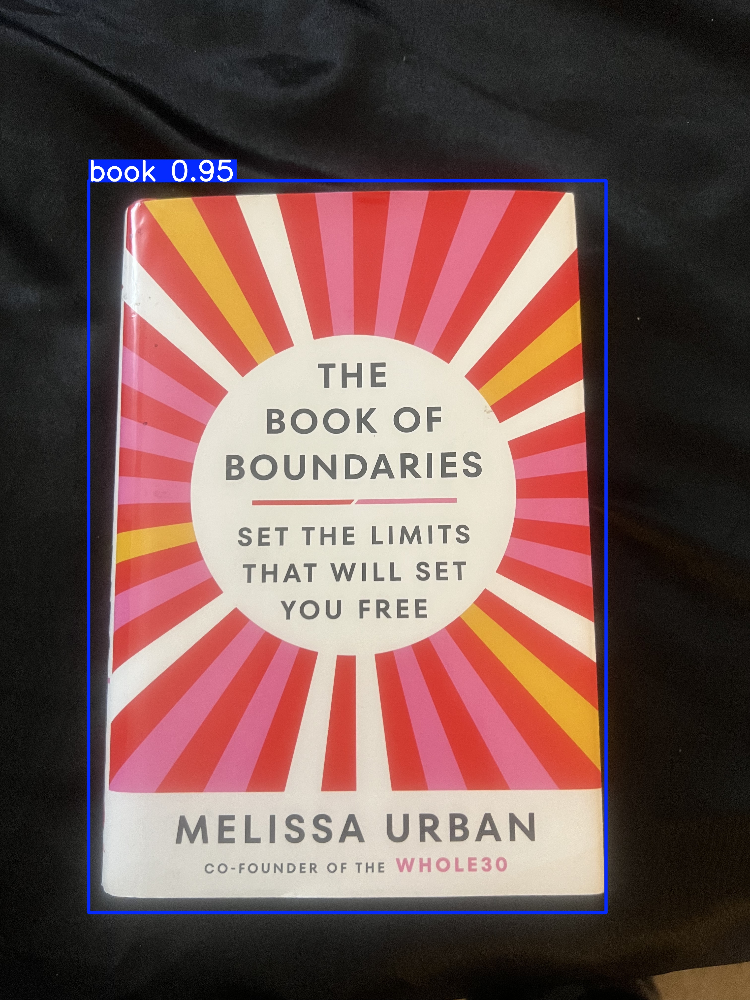

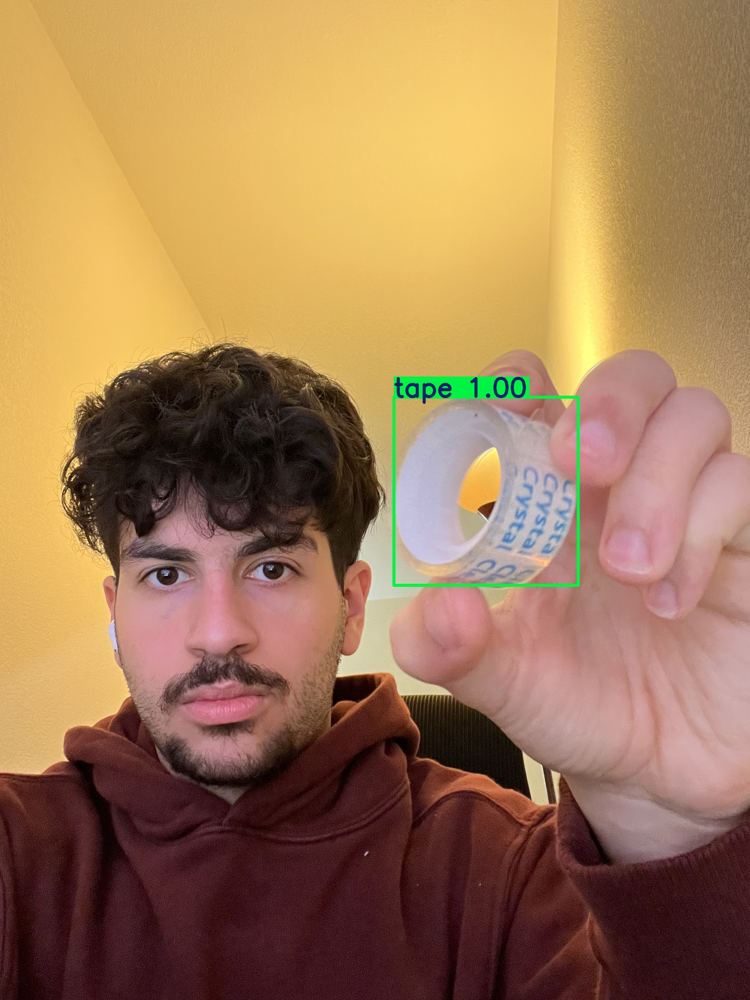

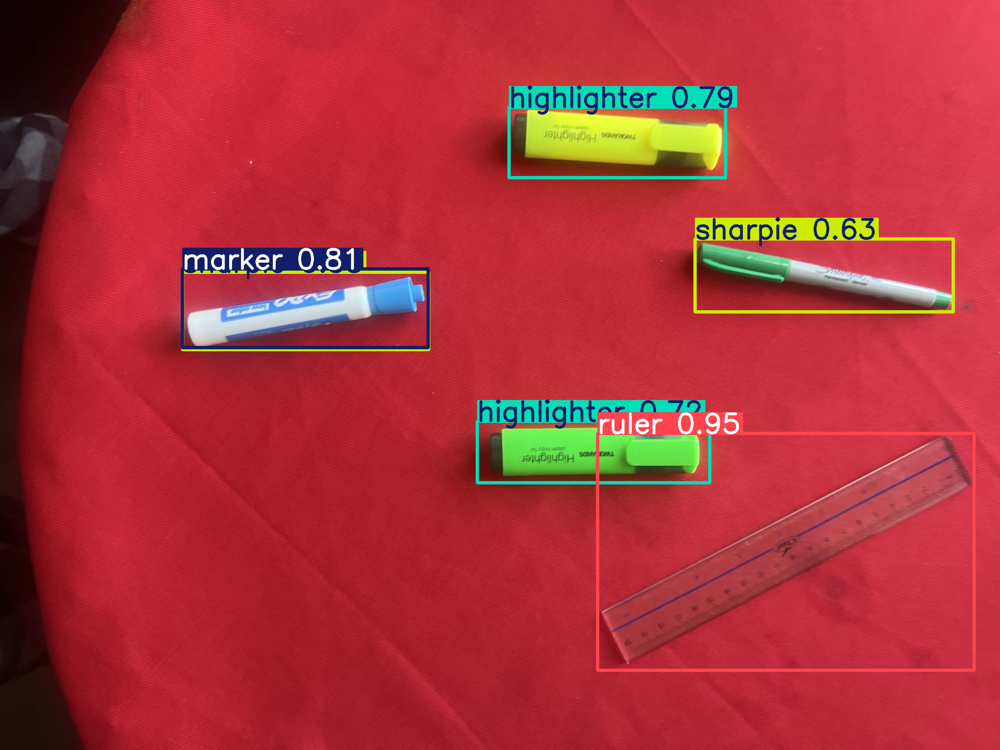

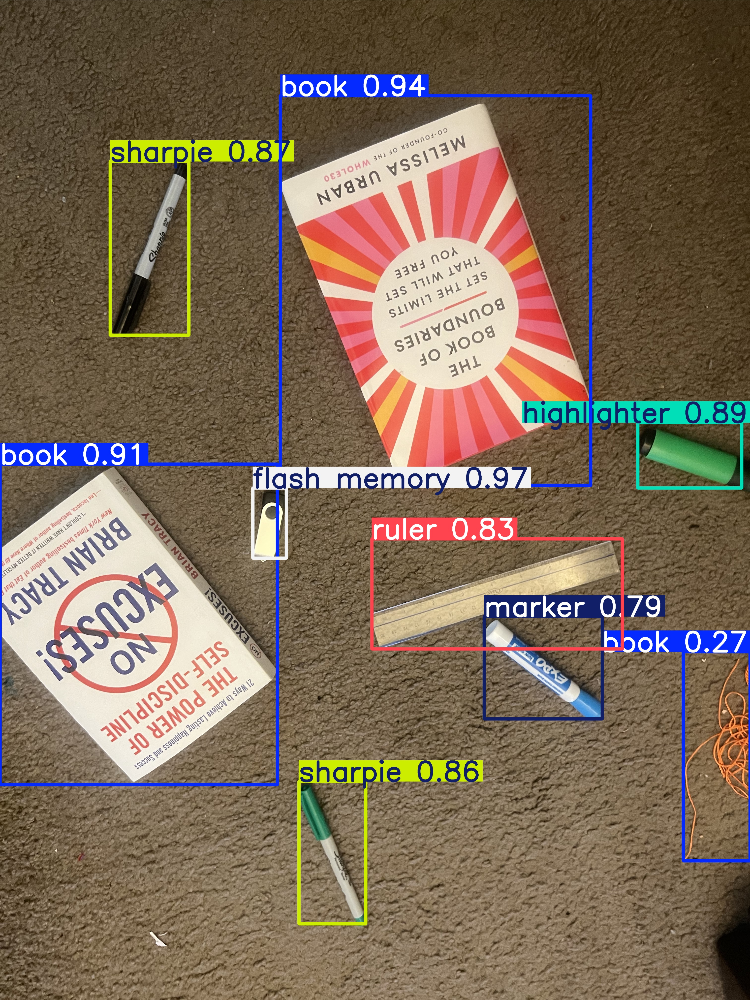

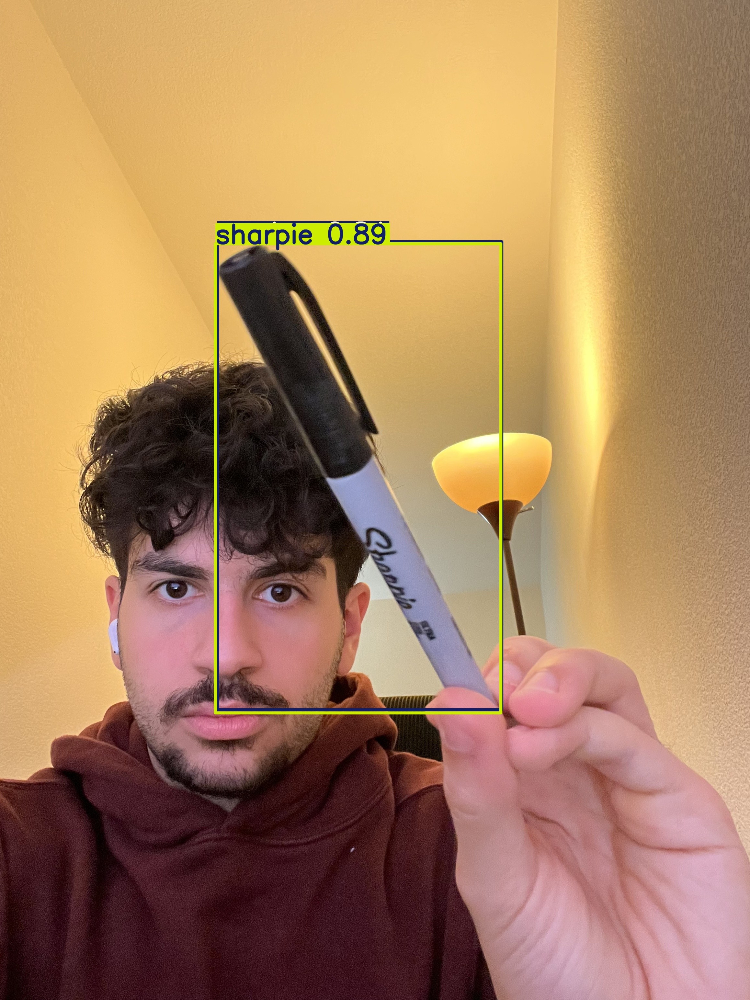

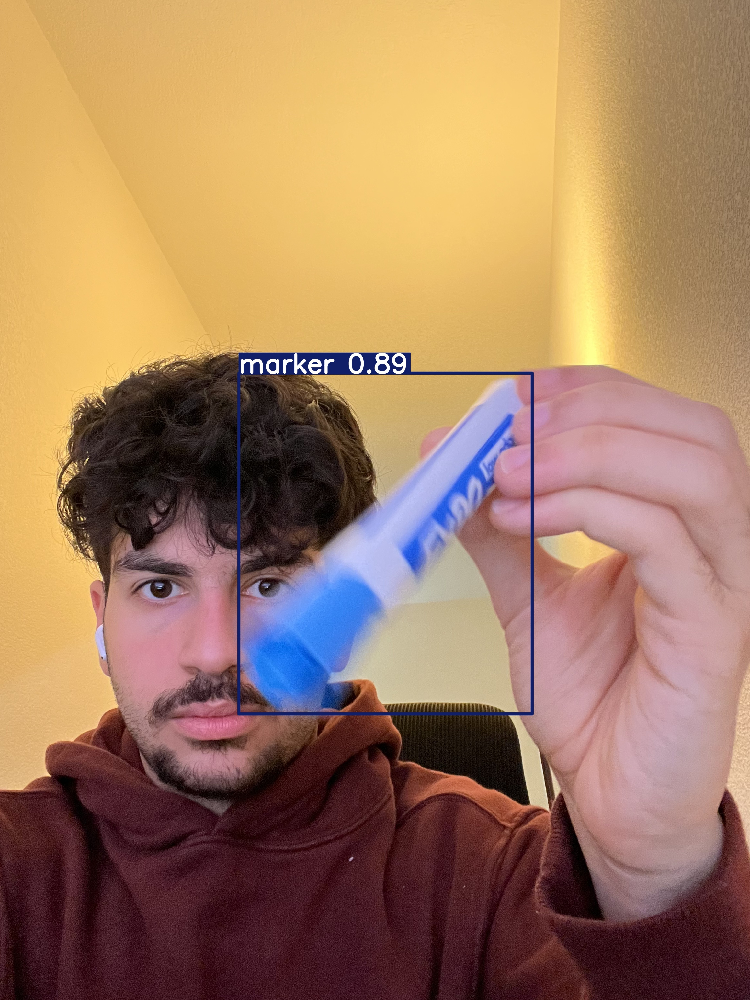

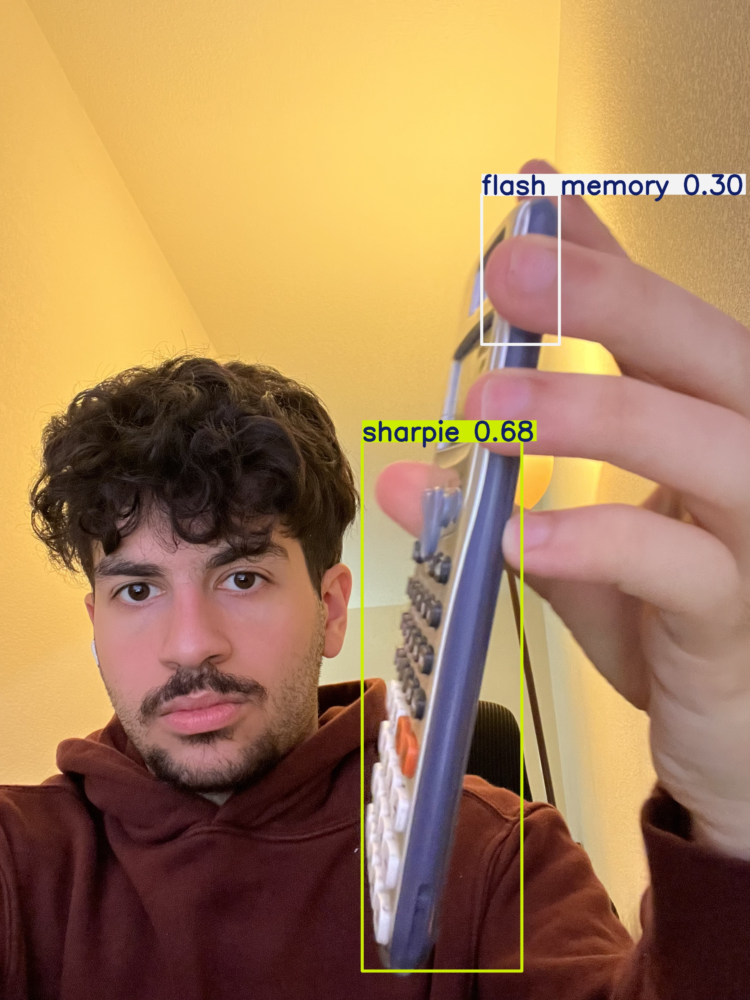

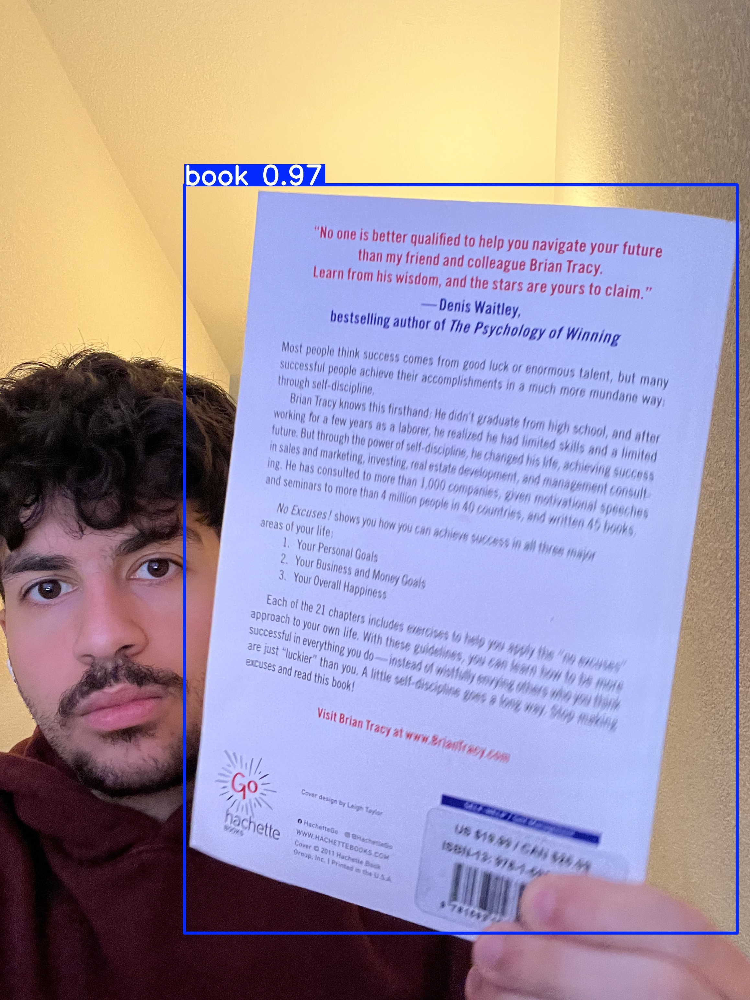

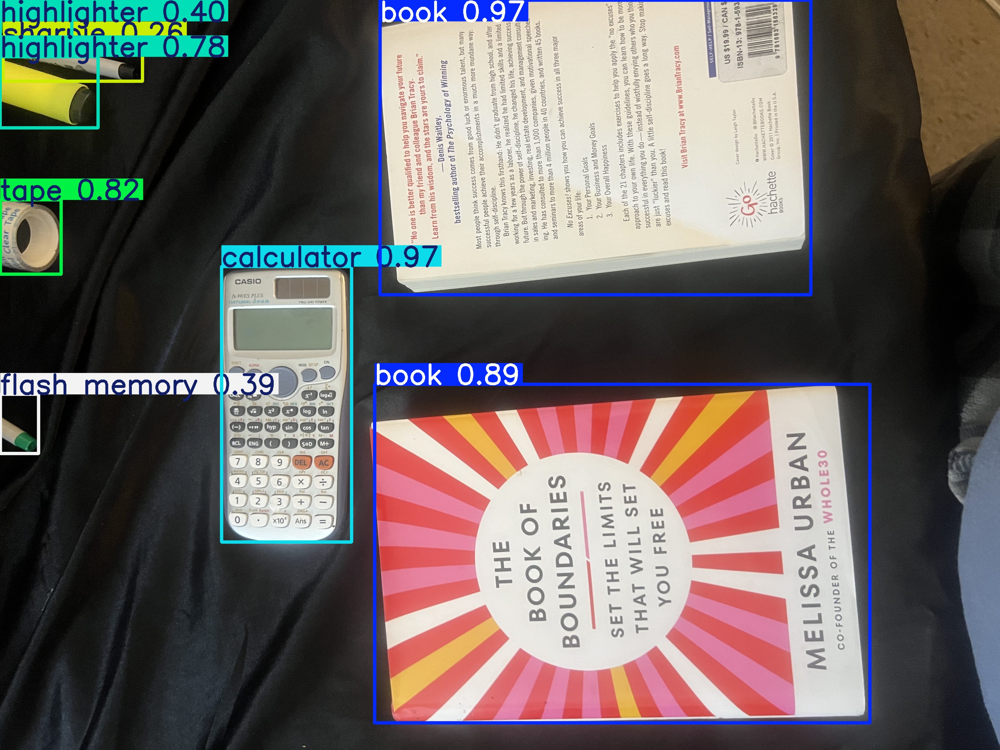

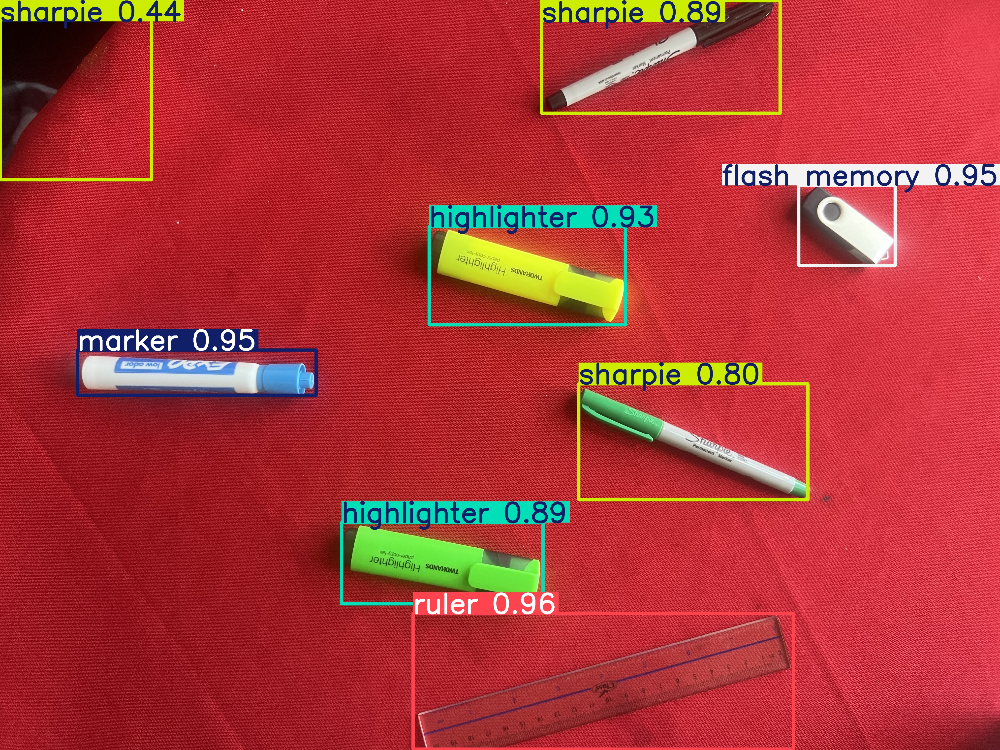

In [14]:
import glob
from IPython.display import Image, display
for image_path in glob.glob(f'/content/runs/detect/predict/*.jpg')[:10]:
  display(Image(filename=image_path, height=400))
  print('\n')

In [17]:
# create "stationary_object_model" folder to store weights and results

!mkdir /content/stationary_object_model
!cp /content/runs/detect/train2/weights/best.pt /content/stationary_object_model/stationary_object_model.pt
!cp -r /content/runs/detect/train /content/stationary_object_model

# Zip the folder
%cd stationary_object_model
!zip /content/stationary_object_model.zip stationary_object_model.pt
!zip -r /content/stationary_object_model.zip train2
%cd /content

mkdir: cannot create directory ‘/content/stationary_object_model’: File exists
/content/stationary_object_model
updating: stationary_object_model.pt (deflated 10%)
  adding: train2/ (stored 0%)
  adding: train2/labels_correlogram.jpg (deflated 41%)
  adding: train2/train_batch0.jpg (deflated 4%)
  adding: train2/weights/ (stored 0%)
  adding: train2/weights/last.pt (deflated 10%)
  adding: train2/weights/best.pt (deflated 10%)
  adding: train2/BoxF1_curve.png (deflated 5%)
  adding: train2/confusion_matrix.png (deflated 24%)
  adding: train2/train_batch2.jpg (deflated 3%)
  adding: train2/train_batch1.jpg (deflated 4%)
  adding: train2/train_batch392.jpg (deflated 12%)
  adding: train2/results.png (deflated 7%)
  adding: train2/args.yaml (deflated 53%)
  adding: train2/train_batch391.jpg (deflated 9%)
  adding: train2/results.csv (deflated 61%)
  adding: train2/BoxP_curve.png (deflated 7%)
  adding: train2/val_batch0_labels.jpg (deflated 10%)
  adding: train2/confusion_matrix_normalize

In [18]:
from google.colab import files

files.download('/content/stationary_object_model.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>